# Summary

Name: Pratham S Sanshi


## Data Set details: Imbalanced Dataset
* 0->false->               25% (48)
* 1->true->                75% (147)
* number of observations-  195
* Number of variables-      24
* Missing cells-             0
* Duplicate rows-            0
* Categorical-               2
* Numeric-                   22



## Analysing metrics:
* The given data set is **imbalanced** hence accuracy cannot be the most efficient method to determine the efficiency of algo.
* In this case we have parkinson's Disease where **False negative** needs to be reduced and ideally it **should be zero** hence    **recall for 1 should be one**. 
* For this Data set we use **F2Beta Score which should be ideally 100%**.

## Ideal-Objective
* Recall of test dataset for true[1] should be 1.
* F2Beta of test dataset Score should be 100%
* Accuracy for train and test should be 100%

# Algorithm used :
* Logestic Regression 
* Logestic Regression + Stratified Cross Validation
* Logestic Regression + PCA
* Logestic Regression + LDA
* Support Vector Machine + rbf(kernel) 
* Support Vector Machine + poly(kernel with degree=5)
* Support Vector Machine + rbf(kernel) 
* Support Vector Machine + poly(kernel) + Stratified Cross Validation
* Support Vector Machine + poly(kernel) + PCA
* Support Vector Machine + poly(kernel) + LDA
* Decision Tree +gini(kernel)
* Decision Tree +entropy(kernel)
* Decision Tree +entropy(kernel) + Stratified Cross Validation
* Decision Tree +entropy(kernel) + Adaboost
* Decision Tree +entropy(kernel) + PCA
* Decision Tree +entropy(kernel) + LDA
* Random Forest
* Random Forest + Adaboost
* Random Forest + Stratified Cross Validation
* Random Forest + PCA
* Random Forest + LDA
* KNN
* KNN + Stratified Cross Validation
* KNN + PCA
* KNN + LDA
* NB
* NB + Adaboost
* NB + Stratified Cross Validation

## Conclusion:
**After comparing all the results the most reliable algo is :**

### 1st
**Decision Tree(entropy) + Adaboost
Train accuracy: 100%
Test Accuracy : 92.30%
Recall for true(1): 0.94
Recall for false(0): 0.88
F2Beta Score : 89.76%    

### 2nd
**Random Forest
Train accuracy: 100%
Test Accuracy : 92.30%
Recall for true(1): 0.95
Recall for false(0): 0.75
F2Beta Score : 86%

In [226]:

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report 
from sklearn.metrics import fbeta_score
from sklearn.ensemble import AdaBoostClassifier

In [227]:
os.chdir('D:\\project_ds')
df1 = pd.read_csv('parkinsons.data')
print (pd.DataFrame(df1))

               name  MDVP:Fo(Hz)  MDVP:Fhi(Hz)  MDVP:Flo(Hz)  MDVP:Jitter(%)  \
0    phon_R01_S01_1      119.992       157.302        74.997         0.00784   
1    phon_R01_S01_2      122.400       148.650       113.819         0.00968   
2    phon_R01_S01_3      116.682       131.111       111.555         0.01050   
3    phon_R01_S01_4      116.676       137.871       111.366         0.00997   
4    phon_R01_S01_5      116.014       141.781       110.655         0.01284   
..              ...          ...           ...           ...             ...   
190  phon_R01_S50_2      174.188       230.978        94.261         0.00459   
191  phon_R01_S50_3      209.516       253.017        89.488         0.00564   
192  phon_R01_S50_4      174.688       240.005        74.287         0.01360   
193  phon_R01_S50_5      198.764       396.961        74.904         0.00740   
194  phon_R01_S50_6      214.289       260.277        77.973         0.00567   

     MDVP:Jitter(Abs)  MDVP:RAP  MDVP:P

In [228]:
import pandas_profiling as pf
display(pf.ProfileReport(df1))


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [229]:
display (df1.dtypes )

name                 object
MDVP:Fo(Hz)         float64
MDVP:Fhi(Hz)        float64
MDVP:Flo(Hz)        float64
MDVP:Jitter(%)      float64
MDVP:Jitter(Abs)    float64
MDVP:RAP            float64
MDVP:PPQ            float64
Jitter:DDP          float64
MDVP:Shimmer        float64
MDVP:Shimmer(dB)    float64
Shimmer:APQ3        float64
Shimmer:APQ5        float64
MDVP:APQ            float64
Shimmer:DDA         float64
NHR                 float64
HNR                 float64
status                int64
RPDE                float64
DFA                 float64
spread1             float64
spread2             float64
D2                  float64
PPE                 float64
dtype: object

In [230]:
print (df1.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 195 entries, 0 to 194
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   name              195 non-null    object 
 1   MDVP:Fo(Hz)       195 non-null    float64
 2   MDVP:Fhi(Hz)      195 non-null    float64
 3   MDVP:Flo(Hz)      195 non-null    float64
 4   MDVP:Jitter(%)    195 non-null    float64
 5   MDVP:Jitter(Abs)  195 non-null    float64
 6   MDVP:RAP          195 non-null    float64
 7   MDVP:PPQ          195 non-null    float64
 8   Jitter:DDP        195 non-null    float64
 9   MDVP:Shimmer      195 non-null    float64
 10  MDVP:Shimmer(dB)  195 non-null    float64
 11  Shimmer:APQ3      195 non-null    float64
 12  Shimmer:APQ5      195 non-null    float64
 13  MDVP:APQ          195 non-null    float64
 14  Shimmer:DDA       195 non-null    float64
 15  NHR               195 non-null    float64
 16  HNR               195 non-null    float64
 1

In [231]:
print(df1.describe)

<bound method NDFrame.describe of                name  MDVP:Fo(Hz)  MDVP:Fhi(Hz)  MDVP:Flo(Hz)  MDVP:Jitter(%)  \
0    phon_R01_S01_1      119.992       157.302        74.997         0.00784   
1    phon_R01_S01_2      122.400       148.650       113.819         0.00968   
2    phon_R01_S01_3      116.682       131.111       111.555         0.01050   
3    phon_R01_S01_4      116.676       137.871       111.366         0.00997   
4    phon_R01_S01_5      116.014       141.781       110.655         0.01284   
..              ...          ...           ...           ...             ...   
190  phon_R01_S50_2      174.188       230.978        94.261         0.00459   
191  phon_R01_S50_3      209.516       253.017        89.488         0.00564   
192  phon_R01_S50_4      174.688       240.005        74.287         0.01360   
193  phon_R01_S50_5      198.764       396.961        74.904         0.00740   
194  phon_R01_S50_6      214.289       260.277        77.973         0.00567   

     

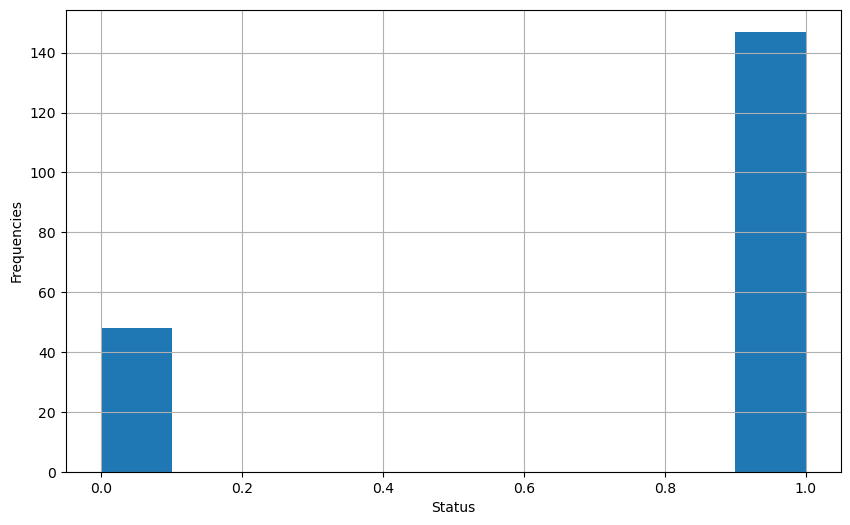

In [232]:
# The dataset has high number of patients effected with Parkinson's disease.
%matplotlib inline
plt.figure(figsize=(10, 6))
df1.status.hist()
plt.xlabel('Status')
plt.ylabel('Frequencies')
plt.plot()
plt.show()

In [233]:
#Define X and Y and split
df1.drop(['name'],axis=1,inplace=True)
X=df1.drop(labels=['status'],axis=1)
display (X.head())
Y=df1['status']
display (Y.head())

 

X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.2,random_state=40)
print (X.shape,Y.shape)
print(X_train.shape,X_test.shape,Y_train.shape,Y_test.shape)

,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,MDVP:APQ,Shimmer:DDA,NHR,HNR,RPDE,DFA,spread1,spread2,D2,PPE
0,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,0.426,...,0.02971,0.06545,0.02211,21.033,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,0.626,...,0.04368,0.09403,0.01929,19.085,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,0.482,...,0.03590,0.08270,0.01309,20.651,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,0.517,...,0.03772,0.08771,0.01353,20.644,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,0.584,...,0.04465,0.10470,0.01767,19.649,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335


0    1
1    1
2    1
3    1
4    1
Name: status, dtype: int64

(195, 22) (195,)
(156, 22) (39, 22) (156,) (39,)


In [234]:
#logistic Regression
log_reg = LogisticRegression(solver='lbfgs').fit(X_train, Y_train)
#predict on train 
train_preds = log_reg.predict(X_train)
#accuracy on train
print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds))

#predict on test
test_preds = log_reg.predict(X_test)
#accuracy on test
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds))
print('-'*50)

#Confusion matrix
print("confusion_matrix train is:\n ", confusion_matrix(Y_train, train_preds))
print("confusion_matrix test is:\n ", confusion_matrix(Y_test, test_preds))
print('\nClassification Report Train is ')
print(classification_report (Y_train, train_preds))
print('\nClassification Report Test is ')
print(classification_report (Y_test, test_preds))
print("Fbeat Score = ",fbeta_score(Y_test, test_preds, average='macro', beta=2))


Model accuracy on train is:  0.8782051282051282
Model accuracy on test is:  0.8461538461538461
--------------------------------------------------
confusion_matrix train is:
  [[ 25  15]
 [  4 112]]
confusion_matrix test is:
  [[ 5  3]
 [ 3 28]]

Classification Report Train is 
              precision    recall  f1-score   support

           0       0.86      0.62      0.72        40
           1       0.88      0.97      0.92       116

    accuracy                           0.88       156
   macro avg       0.87      0.80      0.82       156
weighted avg       0.88      0.88      0.87       156


Classification Report Test is 
              precision    recall  f1-score   support

           0       0.62      0.62      0.62         8
           1       0.90      0.90      0.90        31

    accuracy                           0.85        39
   macro avg       0.76      0.76      0.76        39
weighted avg       0.85      0.85      0.85        39

Fbeat Score =  0.7641129032258065


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [235]:
print("\n Stratified Cross Validation for Logistic Regression\n")

from sklearn.datasets import fetch_openml
import pandas as pd
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score

acc=[]
f2=[]
skf = StratifiedKFold(n_splits=5)
fold_no = 1
for train_index, test_index in skf.split(X,Y):
    sx_train = X.loc[train_index,:]
    sx_test = X.loc[test_index,:]
    sy_train=Y.loc[train_index]
    sy_test=Y.loc[test_index]
    print("Fold no" ,fold_no)
    print("No of examples = ",len(sy_test))
    print("Ratio of 1 to 0 = ",sum(sy_test)/len(sy_test))
    fold_no += 1
    #print(sx_test) #195/5 =39 testset in each splits
    #print(sy_test)
    train_preds = log_reg.predict(sx_test)
    acc.append(accuracy_score(sy_test, train_preds))
    print("Fold accuracy is: ", accuracy_score(sy_test, train_preds))
    print("Fbeat Score = ",fbeta_score(Y_test, test_preds, average='macro', beta=2))
    f2.append(fbeta_score(sy_test, train_preds, average='macro', beta=2))
    
    print("\n\n")
    
    
import statistics
mean1= statistics.mean(acc)
print("Mean Accuracy of stratified Kfold = ",mean1)
print("Mean Accuracy of f2Beta = ",statistics.mean(f2))
variance = sum([((x - mean1) ** 2) for x in acc]) / len(acc)
res = variance ** 0.5
print("Standard Deviation = ",res)




 Stratified Cross Validation for Logistic Regression

Fold no 1
No of examples =  39
Ratio of 1 to 0 =  0.7692307692307693
Fold accuracy is:  0.9487179487179487
Fbeat Score =  0.7641129032258065



Fold no 2
No of examples =  39
Ratio of 1 to 0 =  0.7692307692307693
Fold accuracy is:  0.8461538461538461
Fbeat Score =  0.7641129032258065



Fold no 3
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.8717948717948718
Fbeat Score =  0.7641129032258065



Fold no 4
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.7948717948717948
Fbeat Score =  0.7641129032258065



Fold no 5
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.8974358974358975
Fbeat Score =  0.7641129032258065



Mean Accuracy of stratified Kfold =  0.8717948717948718
Mean Accuracy of f2Beta =  0.7873230299833713
Standard Deviation =  0.051282051282051294


In [236]:
#Support vector Machine kernel rbf
from sklearn.svm import SVC
classifier = SVC (kernel = 'rbf')
classifier.fit (X_train,Y_train)

y_pred= classifier.predict(X_test)
print (y_pred)

print (accuracy_score (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print(confusion_matrix(Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test,y_pred, average='macro', beta=2))

print("\n")

y_pred= classifier.predict(X_train)
print (y_pred)
print (accuracy_score (Y_train,y_pred))
print(classification_report (Y_train,y_pred))
print(confusion_matrix(Y_train,y_pred))


[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1
 0 1]
0.8205128205128205
              precision    recall  f1-score   support

           0       0.67      0.25      0.36         8
           1       0.83      0.97      0.90        31

    accuracy                           0.82        39
   macro avg       0.75      0.61      0.63        39
weighted avg       0.80      0.82      0.79        39

[[ 2  6]
 [ 1 30]]
Fbeta Score =  0.6116071428571428


[1 1 1 1 1 0 1 0 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1]
0.8141025641025641
              precision    recall  f1-score   support

           0       1.00      0.28      0.43        40
           1       0.80      1.00      0.89       116

    accuracy     

In [237]:
#Support vector Machine kernel poly
from sklearn.svm import SVC
classifier = SVC (kernel = 'poly',degree=5)
classifier.fit (X_train,Y_train)

y_pred= classifier.predict(X_test)
print (y_pred)

print (accuracy_score (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print(confusion_matrix(Y_test,y_pred))
print("Fbeat Score = ",fbeta_score(Y_test, y_pred, average='macro', beta=2))
print("\n")

y_pred= classifier.predict(X_train)
print (y_pred)
print (accuracy_score (Y_train,y_pred))
print(classification_report (Y_train,y_pred))
print(confusion_matrix(Y_train,y_pred))

[1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 1 1 1 1
 1 1]
0.9230769230769231
              precision    recall  f1-score   support

           0       1.00      0.62      0.77         8
           1       0.91      1.00      0.95        31

    accuracy                           0.92        39
   macro avg       0.96      0.81      0.86        39
weighted avg       0.93      0.92      0.92        39

[[ 5  3]
 [ 0 31]]
Fbeat Score =  0.8283441669517619


[1 1 1 1 1 0 1 0 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 0 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 1 1 0 1 1 1
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 0 1 1]
0.8461538461538461
              precision    recall  f1-score   support

           0       1.00      0.40      0.57        40
           1       0.83      1.00      0.91       116

    accuracy     

In [238]:
print("\n Stratified Cross Validation\n")

from sklearn.datasets import fetch_openml

from sklearn.model_selection import StratifiedKFold


f2=[]
acc=[]
skf = StratifiedKFold(n_splits=5)
fold_no = 1
for train_index, test_index in skf.split(X,Y):
    sx_train = X.loc[train_index,:]
    sx_test = X.loc[test_index,:]
    sy_train=Y.loc[train_index]
    sy_test=Y.loc[test_index]
    print("Fold no" ,fold_no)
    print("No of examples = ",len(sy_test))
    print("Ratio of 1 to 0 = ",sum(sy_test)/len(sy_test))
    fold_no += 1
    #print(sx_test) #195/5 =39 testset in each splits
    #print(sy_test)
    y_pred= classifier.predict(sx_test)
    acc.append(accuracy_score(sy_test, y_pred))
    print("Fold accuracy is: ", accuracy_score(sy_test, train_preds))
    f2.append(fbeta_score(sy_test, train_preds, average='macro', beta=2))
    print("\n\n")
    
    
import statistics
mean1= statistics.mean(acc)
print("Mean Accuracy of stratified Kfold = ",mean1)
print("Mean Accuracy of f2Beta = ", statistics.mean(f2))
variance = sum([((x - mean1) ** 2) for x in acc]) / len(acc)
res = variance ** 0.5
print("Standard Deviation = ",res)




 Stratified Cross Validation

Fold no 1
No of examples =  39
Ratio of 1 to 0 =  0.7692307692307693
Fold accuracy is:  0.9230769230769231



Fold no 2
No of examples =  39
Ratio of 1 to 0 =  0.7692307692307693
Fold accuracy is:  0.6153846153846154



Fold no 3
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.6923076923076923



Fold no 4
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.8974358974358975



Fold no 5
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.8974358974358975



Mean Accuracy of stratified Kfold =  0.8615384615384615
Mean Accuracy of f2Beta =  0.6785965626402297
Standard Deviation =  0.06405126152203487


In [239]:
#Decision Tree
from sklearn.tree import DecisionTreeClassifier
dt= DecisionTreeClassifier()
dt.fit (X_train , Y_train)
y_pred=dt.predict (X_train)
print(pd.DataFrame(Y_train),"\n")
print(y_pred)               

print (accuracy_score (y_pred,Y_train))
print(classification_report (y_pred,Y_train))
print(confusion_matrix (y_pred,Y_train))



y_pred=dt.predict (X_test)
print(y_pred)
print (accuracy_score (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print(confusion_matrix (Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test,y_pred, average='macro', beta=2))

     status
147       1
86        1
179       1
69        1
125       1
..      ...
50        0
184       0
165       0
7         1
70        1

[156 rows x 1 columns] 

[1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1
 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1
 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 0 0 0 1 1]
1.0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        40
           1       1.00      1.00      1.00       116

    accuracy                           1.00       156
   macro avg       1.00      1.00      1.00       156
weighted avg       1.00      1.00      1.00       156

[[ 40   0]
 [  0 116]]
[1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 1 1 1 1 0 1 0 1 1 1 1 1 1 1 1 0 0 0 1 1 1 1
 1 1]
0.9230769230769231
              precision    recall  f1-score   support

   

In [240]:
#Decision Tree
from sklearn.tree import DecisionTreeClassifier
dt= DecisionTreeClassifier(criterion = 'entropy')
dt.fit (X_train , Y_train)
y_pred=dt.predict (X_train)
print(y_pred)

print (accuracy_score (Y_train,y_pred))
print(classification_report (Y_train,y_pred))
print(confusion_matrix (Y_train,y_pred))



y_pred=dt.predict (X_test)
print(y_pred)
print (accuracy_score (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print(confusion_matrix (Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test,y_pred, average='macro', beta=2))

[1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1
 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1
 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 0 0 0 1 1]
1.0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        40
           1       1.00      1.00      1.00       116

    accuracy                           1.00       156
   macro avg       1.00      1.00      1.00       156
weighted avg       1.00      1.00      1.00       156

[[ 40   0]
 [  0 116]]
[1 1 1 1 1 0 1 1 1 0 1 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 0 0 1 1 1
 1 1]
0.8974358974358975
              precision    recall  f1-score   support

           0       0.75      0.75      0.75         8
           1       0.94      0.94      0.94        31

    accuracy                           0.90        39
   macro a

In [241]:
#decision Tree with adaboost
AdaBoost= AdaBoostClassifier(base_estimator = dt, n_estimators = 10, learning_rate =1)
boostmodel= AdaBoost.fit(X_train,Y_train)
y_pred= boostmodel.predict(X_train)
print(y_pred)
print('Accuracy Score')
print (accuracy_score (Y_train,y_pred),'\n')
print(classification_report (Y_train,y_pred))
print (confusion_matrix (Y_train,y_pred))





y_pred= boostmodel.predict(X_test)
print(y_pred)
print('Accuracy Score')
print (accuracy_score (Y_test,y_pred),'\n')
print('Confusion Matrix')
print (confusion_matrix (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test,y_pred, average='macro', beta=2))



[1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1
 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1
 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 0 0 0 1 1]
Accuracy Score
1.0 

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        40
           1       1.00      1.00      1.00       116

    accuracy                           1.00       156
   macro avg       1.00      1.00      1.00       156
weighted avg       1.00      1.00      1.00       156

[[ 40   0]
 [  0 116]]
[1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 0 0 1 1 1
 1 1]
Accuracy Score
0.9230769230769231 

Confusion Matrix
[[ 7  1]
 [ 2 29]]
              precision    recall  f1-score   support

           0       0.78      0.88      0.82         8
           1       0.97      0.94      0.95      

In [242]:
print("\n Stratified Cross Validation with decision Tree\n")

from sklearn.datasets import fetch_openml

from sklearn.model_selection import StratifiedKFold

f2=[]
acc=[]
skf = StratifiedKFold(n_splits=5)
fold_no = 1
for train_index, test_index in skf.split(X,Y):
    sx_train = X.loc[train_index,:]
    sx_test = X.loc[test_index,:]
    sy_train=Y.loc[train_index]
    sy_test=Y.loc[test_index]
    print("Fold no" ,fold_no)
    print("No of examples = ",len(sy_test))
    print("Ratio of 1 to 0 = ",sum(sy_test)/len(sy_test))
    fold_no += 1
    #print(sx_test) #195/5 =39 testset in each splits
    #print(sy_test)
    y_pred= dt.predict(sx_test)
    acc.append(accuracy_score(sy_test, y_pred))
    print("Fold accuracy is: ", accuracy_score(sy_test, y_pred))
    f2.append(fbeta_score(sy_test, y_pred, average='macro', beta=2))
    print("\n\n")
    
    
import statistics
mean1=sum(acc)/len(acc)
print("Mean Accuracy of stratified Kfold = ",mean1)
print("Mean Accuracy of FBeta = ",statistics.mean(f2))
variance = sum([((x - mean1) ** 2) for x in acc]) / len(acc)
res = variance ** 0.5
print("Standard Deviation = ",res)




 Stratified Cross Validation with decision Tree

Fold no 1
No of examples =  39
Ratio of 1 to 0 =  0.7692307692307693
Fold accuracy is:  0.9487179487179487



Fold no 2
No of examples =  39
Ratio of 1 to 0 =  0.7692307692307693
Fold accuracy is:  1.0



Fold no 3
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  1.0



Fold no 4
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.9743589743589743



Fold no 5
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.9743589743589743



Mean Accuracy of stratified Kfold =  0.9794871794871796
Mean Accuracy of FBeta =  0.9719687966510805
Standard Deviation =  0.01918798659884074


In [243]:
#Random Forest
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=10, criterion='gini')
rfc.fit (X_train,Y_train)
print (rfc)

y_pred= rfc.predict(X_train)
print (y_pred)
print (accuracy_score (Y_train,y_pred))
print(classification_report (Y_train,y_pred))
print(confusion_matrix (Y_train,y_pred))


y_pred=rfc.predict (X_test)
print(y_pred)
print (accuracy_score (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print(confusion_matrix (Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test,y_pred, average='macro', beta=2))

RandomForestClassifier(n_estimators=10)
[1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1
 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1
 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 0 0 0 1 1]
1.0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        40
           1       1.00      1.00      1.00       116

    accuracy                           1.00       156
   macro avg       1.00      1.00      1.00       156
weighted avg       1.00      1.00      1.00       156

[[ 40   0]
 [  0 116]]
[1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 0 1 1 0 0 0 0 1 1 1
 1 1]
0.8717948717948718
              precision    recall  f1-score   support

           0       0.67      0.75      0.71         8
           1       0.93      0.90      0.92        31

    accuracy            

In [244]:
#Random forest with adaboost
AdaBoost= AdaBoostClassifier(base_estimator = rfc, n_estimators = 10, learning_rate =1)
boostmodel= AdaBoost.fit(X_train,Y_train)
y_pred= boostmodel.predict(X_train)
print(y_pred)
print('Accuracy Score')
print (accuracy_score (Y_train,y_pred),'\n')
print('Confusion Matrix')
print (confusion_matrix (Y_train,y_pred))
print(classification_report (Y_train,y_pred))





y_pred= boostmodel.predict(X_test)
print(y_pred)
print('Accuracy Score')
print (accuracy_score (Y_test,y_pred),'\n')
print('Confusion Matrix')
print (confusion_matrix (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test,y_pred, average='macro', beta=2))



[1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1
 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1
 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 0 0 0 1 1]
Accuracy Score
1.0 

Confusion Matrix
[[ 40   0]
 [  0 116]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        40
           1       1.00      1.00      1.00       116

    accuracy                           1.00       156
   macro avg       1.00      1.00      1.00       156
weighted avg       1.00      1.00      1.00       156

[1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 0 0 1 1 1 1
 0 1]
Accuracy Score
0.8974358974358975 

Confusion Matrix
[[ 5  3]
 [ 1 30]]
              precision    recall  f1-score   support

           0       0.83      0.62      0.71         8
           1       0.91      0.9

In [245]:
print("\n Stratified Cross Validation\n")

from sklearn.datasets import fetch_openml

from sklearn.model_selection import StratifiedKFold

f2=[]
acc=[]
skf = StratifiedKFold(n_splits=5)
fold_no = 1
for train_index, test_index in skf.split(X,Y):
    sx_train = X.loc[train_index,:]
    sx_test = X.loc[test_index,:]
    sy_train=Y.loc[train_index]
    sy_test=Y.loc[test_index]
    print("Fold no" ,fold_no)
    print("No of examples = ",len(sy_test))
    print("Ratio of 1 to 0 = ",sum(sy_test)/len(sy_test))
    fold_no += 1
    #print(sx_test) #195/5 =39 testset in each splits
    #print(sy_test)
    y_pred= rfc.predict(sx_test)
    acc.append(accuracy_score(sy_test, y_pred))
    f2.append(fbeta_score(sy_test, y_pred, average='macro', beta=2))
    print("Fold accuracy is: ", accuracy_score(sy_test, y_pred))
    print("\n\n")
    
    
import statistics
mean1= statistics.mean(acc)
print("Mean Accuracy of stratified Kfold = ",mean1)
print("Mean Accuracy of FBeta = ",statistics.mean(f2))

variance = sum([((x - mean1) ** 2) for x in acc]) / len(acc)
res = variance ** 0.5
print("Standard Deviation = ",res)




 Stratified Cross Validation

Fold no 1
No of examples =  39
Ratio of 1 to 0 =  0.7692307692307693
Fold accuracy is:  1.0



Fold no 2
No of examples =  39
Ratio of 1 to 0 =  0.7692307692307693
Fold accuracy is:  1.0



Fold no 3
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.9743589743589743



Fold no 4
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.9487179487179487



Fold no 5
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.9487179487179487



Mean Accuracy of stratified Kfold =  0.9743589743589743
Mean Accuracy of FBeta =  0.9683648861843588
Standard Deviation =  0.0229340305384594


In [246]:
#KNN
from sklearn.neighbors import KNeighborsClassifier
KNN = KNeighborsClassifier(n_neighbors =5 , metric = 'minkowski', p= 2)
KNN.fit(X_train,Y_train)
print (KNN)
y_pred = KNN.predict(X_train)
print (y_pred)

y_pred= KNN.predict(X_train)
print (y_pred)
print (accuracy_score (Y_train,y_pred))
print(classification_report (Y_train,y_pred))
print(confusion_matrix (Y_train,y_pred))


y_pred=KNN.predict (X_test)
print(y_pred)
print (accuracy_score (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print(confusion_matrix (Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test,y_pred, average='macro', beta=2))



KNeighborsClassifier()
[1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 0 0 0 1 0 1 1 0 1 1 1 0 1 1 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1
 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 0 1 1 1 1
 1 0 1 1 1 1 1 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 0 1
 1 1 1 0 1 0 1 1]
[1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 0 0 0 1 0 1 1 0 1 1 1 0 1 1 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1
 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 0 1 1 1 1
 1 0 1 1 1 1 1 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 0 1
 1 1 1 0 1 0 1 1]
0.9102564102564102
              precision    recall  f1-score   support

           0       0.88      0.75      0.81        40
           1       0.92      0.97      0.94       116

    accuracy                           0.91       156
   macro avg       0.90      0.86      0.88       156
weighted avg       0.91      0.91      0.91       

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

In [247]:
print("\n Stratified Cross Validation\n")

from sklearn.datasets import fetch_openml

from sklearn.model_selection import StratifiedKFold

f2=[]
acc=[]
skf = StratifiedKFold(n_splits=5)
fold_no = 1
for train_index, test_index in skf.split(X,Y):
    sx_train = X.loc[train_index,:]
    sx_test = X.loc[test_index,:]
    sy_train=Y.loc[train_index]
    sy_test=Y.loc[test_index]
    print("Fold no" ,fold_no)
    print("No of examples = ",len(sy_test))
    print("Ratio of 1 to 0 = ",sum(sy_test)/len(sy_test))
    fold_no += 1
    #print(sx_test) #195/5 =39 testset in each splits
    #print(sy_test)
    y_pred= KNN.predict(sx_test)
    acc.append(accuracy_score(sy_test, y_pred))
    print("Fold accuracy is: ", accuracy_score(sy_test, y_pred))
    f2.append(fbeta_score(sy_test, y_pred, average='macro', beta=2))
    print("\n\n")
    
    
import statistics
mean1= statistics.mean(acc)
print("Mean Accuracy of FBeta = ",statistics.mean(f2))
print("Mean Accuracy of stratified Kfold = ",mean1)
variance = sum([((x - mean1) ** 2) for x in acc]) / len(acc)
res = variance ** 0.5
print("Standard Deviation = ",res)




 Stratified Cross Validation

Fold no 1
No of examples =  39
Ratio of 1 to 0 =  0.7692307692307693
Fold accuracy is:  1.0



Fold no 2
No of examples =  39
Ratio of 1 to 0 =  0.7692307692307693
Fold accuracy is:  1.0



Fold no 3
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.9230769230769231



Fold no 4
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.7692307692307693



Fold no 5
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.7948717948717948



Mean Accuracy of FBeta =  0.8394009151661832
Mean Accuracy of stratified Kfold =  0.8974358974358975
Standard Deviation =  0.09864299518805818


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

In [248]:
#NB
from sklearn.naive_bayes import GaussianNB
GNB =  GaussianNB()
GNB.fit (X_train, Y_train)
GNB.predict (X_train)


y_pred= GNB.predict(X_train)
print (y_pred)
print (accuracy_score (Y_train,y_pred))
print(classification_report (Y_train,y_pred))
print(confusion_matrix (Y_train,y_pred))


y_pred=GNB.predict (X_test)
print(y_pred)
print (accuracy_score (Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test,y_pred, average='macro', beta=2))
print(classification_report (Y_test,y_pred))
print(confusion_matrix (Y_test,y_pred))

[1 1 0 1 1 0 0 0 1 1 1 0 0 0 0 0 0 1 0 1 1 0 0 0 0 1 1 1 0 0 1 0 0 1 1 0 1
 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 0 0 1 1 0 1 1 1 1 0 0 1 0 0 0 1 0
 0 0 0 1 1 0 1 1 1 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 0 0 0 1 0 1 0 0 1 0 0 1
 1 0 1 0 1 1 0 0 1 1 0 0 0 1 0 0 0 1 1 1 0 1 0 1 0 1 0 1 1 0 0 1 1 1 1 1 1
 0 1 0 0 0 0 0 1]
0.7307692307692307
              precision    recall  f1-score   support

           0       0.49      0.95      0.64        40
           1       0.97      0.66      0.78       116

    accuracy                           0.73       156
   macro avg       0.73      0.80      0.71       156
weighted avg       0.85      0.73      0.75       156

[[38  2]
 [40 76]]
[1 1 0 0 0 0 1 1 1 0 1 1 0 0 1 1 1 1 0 0 1 0 1 1 0 0 1 0 0 0 0 0 0 0 1 1 1
 0 1]
0.6923076923076923
Fbeta Score =  0.7167832167832167
              precision    recall  f1-score   support

           0       0.40      1.00      0.57         8
           1       1.00      0.61      0.76        31

    accuracy       

In [249]:
#NB with adaboost
AdaBoost= AdaBoostClassifier(base_estimator = GNB, n_estimators = 10, learning_rate =1)
boostmodel= AdaBoost.fit(X_train,Y_train)
y_pred= boostmodel.predict(X_train)
print(y_pred)
print('Accuracy Score')
print (accuracy_score (Y_train,y_pred),'\n')
print('Confusion Matrix')
print (confusion_matrix (Y_train,y_pred))
print(classification_report (Y_train,y_pred))





y_pred= boostmodel.predict(X_test)
print(y_pred)
print('Accuracy Score')
print (accuracy_score (Y_test,y_pred),'\n')
print('Confusion Matrix')
print (confusion_matrix (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test,y_pred, average='macro', beta=2))



[1 1 1 1 0 1 1 0 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 1 1 1 1 1 1 1 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 0 0 1 1 1 1 1 1 1 1 1 0 1 1 0 0 1 1 0
 0 1 1 1 1 0 1 1 1 1 0 0 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 1 1 1 1 1 1 0 1 1
 1 1 1 1 1 1 0 0 1 1 1 1 1 1 1 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 0 0 0 1 1]
Accuracy Score
0.7884615384615384 

Confusion Matrix
[[ 18  22]
 [ 11 105]]
              precision    recall  f1-score   support

           0       0.62      0.45      0.52        40
           1       0.83      0.91      0.86       116

    accuracy                           0.79       156
   macro avg       0.72      0.68      0.69       156
weighted avg       0.77      0.79      0.78       156

[0 1 1 1 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 0 0 1 1 1 1
 1 1]
Accuracy Score
0.717948717948718 

Confusion Matrix
[[ 2  6]
 [ 5 26]]
              precision    recall  f1-score   support

           0       0.29      0.25      0.27         8
           1      

In [250]:
print("\n Stratified Cross Validation with NB\n")

from sklearn.datasets import fetch_openml

from sklearn.model_selection import StratifiedKFold

f2=[]
acc=[]
skf = StratifiedKFold(n_splits=5)
fold_no = 1
for train_index, test_index in skf.split(X,Y):
    sx_train = X.loc[train_index,:]
    sx_test = X.loc[test_index,:]
    sy_train=Y.loc[train_index]
    sy_test=Y.loc[test_index]
   
    print("Fold no" ,fold_no)
    print("No of examples = ",len(sy_test))
    print("Ratio of 1 to 0 = ",sum(sy_test)/len(sy_test))
    fold_no += 1
    #print(sx_test) #195/5 =39 testset in each splits
    #print(sy_test)
    y_pred= GNB.predict(sx_test)
    acc.append(accuracy_score(sy_test, y_pred))
    print("Fold accuracy is: ", accuracy_score(sy_test, train_preds))
    f2.append(fbeta_score(Y_test,y_pred, average='macro', beta=2))
    print("\n\n")
    
    
import statistics
mean1= statistics.mean(acc)
print("Mean Accuracy of stratified Kfold = ",mean1)
print("Mean Accuracy of FBeta = ",statistics.mean(f2))

variance = sum([((x - mean1) ** 2) for x in acc]) / len(acc)
res = variance ** 0.5
print("Standard Deviation = ",res)




 Stratified Cross Validation with NB

Fold no 1
No of examples =  39
Ratio of 1 to 0 =  0.7692307692307693
Fold accuracy is:  0.9230769230769231



Fold no 2
No of examples =  39
Ratio of 1 to 0 =  0.7692307692307693
Fold accuracy is:  0.6153846153846154



Fold no 3
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.6923076923076923



Fold no 4
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.8974358974358975



Fold no 5
No of examples =  39
Ratio of 1 to 0 =  0.7435897435897436
Fold accuracy is:  0.8974358974358975



Mean Accuracy of stratified Kfold =  0.7230769230769231
Mean Accuracy of FBeta =  0.5016118731639724
Standard Deviation =  0.04411448854893654


In [251]:
#PCA
#variables:
#x_pca = n-1 components
#x_pca_2 = 2 components
from sklearn.decomposition import PCA
pca = PCA(n_components = None)
x_pca = pca.fit_transform(X)
#print (pd.DataFrame(x_pca))
print ("variance_ratio_ = ",pca.explained_variance_ratio_)

print("\n")
from sklearn.decomposition import PCA
pca_2 = PCA(n_components = 2)
x_pca_2 = pca_2.fit_transform(X)
print (pd.DataFrame(x_pca_2))
print ("variance_ratio_ = ",pca_2.explained_variance_ratio_)

#split is susing x_pca_2 that is using only 2 components
#splitdata for 2 component
pca_x_train, pca_x_test, y_train, y_test = train_test_split(x_pca_2 , Y, test_size = 0.2, random_state = 0)
print (x_pca_2.shape)
print (pca_x_train.shape)
print (pca_x_test.shape)



variance_ratio_ =  [7.28992685e-01 2.18244614e-01 5.11208836e-02 1.59375083e-03
 3.99918033e-05 6.11307404e-06 1.02242869e-06 4.70266043e-07
 2.64471006e-07 1.15502769e-07 4.47826786e-08 3.52964683e-08
 5.90154039e-09 1.32664162e-09 6.43674308e-10 2.55212607e-10
 4.19671672e-11 1.71134297e-11 4.87158546e-12 2.17732223e-15
 5.44691902e-16 4.47765763e-16]


              0          1
0    -49.702790 -44.495243
1    -54.357102 -11.019336
2    -72.854413 -12.597009
3    -66.304920 -14.114768
4    -62.712834 -15.868356
..          ...        ...
190   35.519192 -12.334597
191   64.388862   0.318811
192   42.746464 -29.497127
193  200.623243 -46.449496
194   71.547360  -7.303870

[195 rows x 2 columns]
variance_ratio_ =  [0.72899269 0.21824461]
(195, 2)
(156, 2)
(39, 2)


In [252]:
#LDA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
lda = LDA()
lda_x = lda.fit_transform(X,Y)
display (pd.DataFrame(lda_x))
print("variance_ratio_ = ",lda.explained_variance_ratio_)

from sklearn.model_selection import train_test_split
lda_x_train, lda_x_test, y_train, y_test = train_test_split(lda_x , Y, test_size = 0.2, random_state = 0)
print (lda_x.shape)
print (lda_x_train.shape)
print (lda_x_test.shape)

,0
0,-0.876433
1,-1.463177
2,-1.010577
3,-1.496416
4,-0.541345
...,...
190,0.474500
191,0.244221
192,4.288489
193,2.248599


variance_ratio_ =  [1.]
(195, 1)
(156, 1)
(39, 1)


In [253]:
#logistic Regression + pca
log_reg = LogisticRegression(solver='lbfgs').fit(pca_x_train, Y_train)
#predict on train 
train_preds = log_reg.predict(pca_x_train)
#accuracy on train
print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds))

#predict on test
test_preds = log_reg.predict(pca_x_test)
#accuracy on test
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds))
print('-'*50)

#Confusion matrix
print("confusion_matrix train is:\n ", confusion_matrix(Y_train, train_preds))
print("confusion_matrix test is:\n ", confusion_matrix(Y_test, test_preds))
print('\nClassification Report Train is ')
print(classification_report (Y_train, train_preds))
print('\nClassification Report Test is ')
print(classification_report (Y_test, test_preds))
print("Fbeta Score = ",fbeta_score(Y_test, test_preds, average='macro', beta=2))

Model accuracy on train is:  0.7435897435897436
Model accuracy on test is:  0.7948717948717948
--------------------------------------------------
confusion_matrix train is:
  [[  2  38]
 [  2 114]]
confusion_matrix test is:
  [[ 0  8]
 [ 0 31]]

Classification Report Train is 
              precision    recall  f1-score   support

           0       0.50      0.05      0.09        40
           1       0.75      0.98      0.85       116

    accuracy                           0.74       156
   macro avg       0.62      0.52      0.47       156
weighted avg       0.69      0.74      0.66       156


Classification Report Test is 
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         8
           1       0.79      1.00      0.89        31

    accuracy                           0.79        39
   macro avg       0.40      0.50      0.44        39
weighted avg       0.63      0.79      0.70        39

Fbeta Score =  0.47546012269938653


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [254]:
#logistic Regression + lda
log_reg = LogisticRegression(solver='lbfgs').fit(lda_x_train, Y_train)
#predict on train 
train_preds = log_reg.predict(lda_x_train)
#accuracy on train
print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds))

#predict on test
test_preds = log_reg.predict(lda_x_test)
#accuracy on test
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds))
print('-'*50)

#Confusion matrix
print("confusion_matrix train is:\n ", confusion_matrix(Y_train, train_preds))
print("confusion_matrix test is:\n ", confusion_matrix(Y_test, test_preds))
print('\nClassification Report Train is ')
print(classification_report (Y_train, train_preds))
print('\nClassification Report Test is ')
print(classification_report (Y_test, test_preds))
print("Fbeta Score = ",fbeta_score(Y_test, test_preds, average='macro', beta=2))

Model accuracy on train is:  0.7435897435897436
Model accuracy on test is:  0.7948717948717948
--------------------------------------------------
confusion_matrix train is:
  [[  0  40]
 [  0 116]]
confusion_matrix test is:
  [[ 0  8]
 [ 0 31]]

Classification Report Train is 
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        40
           1       0.74      1.00      0.85       116

    accuracy                           0.74       156
   macro avg       0.37      0.50      0.43       156
weighted avg       0.55      0.74      0.63       156


Classification Report Test is 
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         8
           1       0.79      1.00      0.89        31

    accuracy                           0.79        39
   macro avg       0.40      0.50      0.44        39
weighted avg       0.63      0.79      0.70        39

Fbeta Score =  0.47546012269938653


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metr

In [255]:
#Support vector Machine kernel poly +pca
from sklearn.svm import SVC
classifier = SVC (kernel = 'poly',degree=5)
classifier.fit (pca_x_train,Y_train)

y_pred= classifier.predict(pca_x_test)
print (y_pred)

print (accuracy_score (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print(confusion_matrix(Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test, y_pred, average='macro', beta=2))
print("\n")

y_pred= classifier.predict(pca_x_train)
print (y_pred)
print (accuracy_score (Y_train,y_pred))
print(classification_report (Y_train,y_pred))
print(confusion_matrix(Y_train,y_pred))

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1]
0.7948717948717948
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         8
           1       0.79      1.00      0.89        31

    accuracy                           0.79        39
   macro avg       0.40      0.50      0.44        39
weighted avg       0.63      0.79      0.70        39

[[ 0  8]
 [ 0 31]]
Fbeta Score =  0.47546012269938653


[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 1 1 1 1 1]
0.75
              precision    recall  f1-score   support

           0       0.67      0.05      0.09        40
           1       0.75      0.99      0.86       116

    accuracy                  

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [256]:
#Support vector Machine kernel poly +lda
from sklearn.svm import SVC
classifier = SVC (kernel = 'poly',degree=5)
classifier.fit (lda_x_train,Y_train)

y_pred= classifier.predict(lda_x_test)
print (y_pred)

print (accuracy_score (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print(confusion_matrix(Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test,y_pred, average='macro', beta=2))
print("\n")

y_pred= classifier.predict(lda_x_train)
print (y_pred)
print (accuracy_score (Y_train,y_pred))
print(classification_report (Y_train,y_pred))
print(confusion_matrix(Y_train,y_pred))

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1]
0.7948717948717948
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         8
           1       0.79      1.00      0.89        31

    accuracy                           0.79        39
   macro avg       0.40      0.50      0.44        39
weighted avg       0.63      0.79      0.70        39

[[ 0  8]
 [ 0 31]]
Fbeta Score =  0.47546012269938653


[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1]
0.7435897435897436
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        40
           1       0.74      1.00      0.85       116

    accuracy    

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metr

In [257]:
#Decision Tree + pca
from sklearn.tree import DecisionTreeClassifier
dt= DecisionTreeClassifier(criterion = 'entropy')
dt.fit (pca_x_train , Y_train)
y_pred=dt.predict (pca_x_train)
print(y_pred)

print (accuracy_score (Y_train,y_pred))
print(classification_report (Y_train,y_pred))
print(confusion_matrix (Y_train,y_pred))



y_pred=dt.predict (pca_x_test)
print(y_pred)
print (accuracy_score (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print(confusion_matrix (Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test, y_pred, average='macro', beta=2))

[1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1
 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1
 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 0 0 0 1 1]
1.0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        40
           1       1.00      1.00      1.00       116

    accuracy                           1.00       156
   macro avg       1.00      1.00      1.00       156
weighted avg       1.00      1.00      1.00       156

[[ 40   0]
 [  0 116]]
[1 1 1 0 1 1 1 1 1 1 1 0 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1]
0.7435897435897436
              precision    recall  f1-score   support

           0       0.25      0.12      0.17         8
           1       0.80      0.90      0.85        31

    accuracy                           0.74        39
   macro a

In [258]:
#Decision Tree + lda
from sklearn.tree import DecisionTreeClassifier
dt= DecisionTreeClassifier(criterion = 'entropy')
dt.fit (lda_x_train , Y_train)
y_pred=dt.predict (lda_x_train)
print(y_pred)

print (accuracy_score (Y_train,y_pred))
print(classification_report (Y_train,y_pred))
print(confusion_matrix (Y_train,y_pred))



y_pred=dt.predict (lda_x_test)
print(y_pred)
print (accuracy_score (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print(confusion_matrix (Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test, y_pred, average='macro', beta=2))

[1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1
 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1
 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 0 0 0 1 1]
1.0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        40
           1       1.00      1.00      1.00       116

    accuracy                           1.00       156
   macro avg       1.00      1.00      1.00       156
weighted avg       1.00      1.00      1.00       156

[[ 40   0]
 [  0 116]]
[0 1 1 0 1 1 0 0 0 1 1 1 1 1 1 0 1 1 1 1 1 0 0 1 1 0 1 1 1 1 1 1 1 1 0 0 1
 0 1]
0.5384615384615384
              precision    recall  f1-score   support

           0       0.08      0.12      0.10         8
           1       0.74      0.65      0.69        31

    accuracy                           0.54        39
   macro a

In [259]:
#Random Forest +pca
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=10, criterion='gini')
rfc.fit (pca_x_train,Y_train)
print (rfc)

y_pred= rfc.predict(pca_x_train)
print (y_pred)
print (accuracy_score (Y_train,y_pred))
print(classification_report (Y_train,y_pred))
print(confusion_matrix (Y_train,y_pred))


y_pred=rfc.predict (pca_x_test)
print(y_pred)
print (accuracy_score (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print(confusion_matrix (Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test, y_pred, average='macro', beta=2))

RandomForestClassifier(n_estimators=10)
[1 1 1 0 1 0 1 0 1 1 1 0 1 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1
 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1
 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 0 0 0 1 1]
0.9935897435897436
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        40
           1       1.00      0.99      1.00       116

    accuracy                           0.99       156
   macro avg       0.99      1.00      0.99       156
weighted avg       0.99      0.99      0.99       156

[[ 40   0]
 [  1 115]]
[1 0 1 1 0 1 1 0 1 0 1 0 0 1 1 1 1 0 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1
 1 1]
0.6666666666666666
              precision    recall  f1-score   support

           0       0.22      0.25      0.24         8
           1       0.80      0.77      0.79        31

    accur

In [260]:
#Random Forest +lda
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=10, criterion='gini')
rfc.fit (lda_x_train,Y_train)
print (rfc)

y_pred= rfc.predict(lda_x_train)
print (y_pred)
print (accuracy_score (Y_train,y_pred))
print(classification_report (Y_train,y_pred))
print(confusion_matrix (Y_train,y_pred))


y_pred=rfc.predict (lda_x_test)
print(y_pred)
print (accuracy_score (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print(confusion_matrix (Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test, y_pred, average='macro', beta=2))

RandomForestClassifier(n_estimators=10)
[1 1 1 1 1 0 1 0 1 1 1 0 1 0 0 1 1 0 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1
 0 1 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1
 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 0 0 0 1 0]
0.9615384615384616
              precision    recall  f1-score   support

           0       0.90      0.95      0.93        40
           1       0.98      0.97      0.97       116

    accuracy                           0.96       156
   macro avg       0.94      0.96      0.95       156
weighted avg       0.96      0.96      0.96       156

[[ 38   2]
 [  4 112]]
[0 1 1 0 1 1 0 0 0 1 1 1 1 1 1 0 1 1 1 1 1 0 0 1 1 0 1 1 0 1 1 1 1 1 0 0 1
 0 1]
0.5128205128205128
              precision    recall  f1-score   support

           0       0.08      0.12      0.10         8
           1       0.73      0.61      0.67        31

    accur

In [261]:
#KNN +pca
from sklearn.neighbors import KNeighborsClassifier
KNN = KNeighborsClassifier(n_neighbors =5 , metric = 'minkowski', p= 2)
KNN.fit(pca_x_train,Y_train)
print (KNN)
y_pred = KNN.predict(pca_x_train)
print (y_pred)

y_pred= KNN.predict(pca_x_train)
print (y_pred)
print (accuracy_score (Y_train,y_pred))
print(classification_report (Y_train,y_pred))
print(confusion_matrix (Y_train,y_pred))


y_pred=KNN.predict (pca_x_test)
print(y_pred)
print (accuracy_score (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print(confusion_matrix (Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test, y_pred, average='macro', beta=2))

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


KNeighborsClassifier()
[1 1 1 0 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 1 0 0 0 1 0 1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 1
 0 0 1 1 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 1 1 1 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 1 1 1 1 0 1
 1 1 1 1 1 1 1 1]
[1 1 1 0 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 1 0 0 0 1 0 1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 1
 0 0 1 1 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 1 1 1 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 1 1 1 1 0 1
 1 1 1 1 1 1 1 1]
0.75
              precision    recall  f1-score   support

           0       0.52      0.33      0.40        40
           1       0.79      0.90      0.84       116

    accuracy                           0.75       156
   macro avg       0.66      0.61      0.62       156
weighted avg       0.72      0.75      0.73       156

[[ 13  27

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

In [262]:
#KNN +lda
from sklearn.neighbors import KNeighborsClassifier
KNN = KNeighborsClassifier(n_neighbors =5 , metric = 'minkowski', p= 2)
KNN.fit(lda_x_train,Y_train)
print (KNN)
y_pred = KNN.predict(lda_x_train)
print (y_pred)

y_pred= KNN.predict(lda_x_train)
print (y_pred)
print (accuracy_score (Y_train,y_pred))
print(classification_report (Y_train,y_pred))
print(confusion_matrix (Y_train,y_pred))


y_pred=KNN.predict (lda_x_test)
print(y_pred)
print (accuracy_score (Y_test,y_pred))
print(classification_report (Y_test,y_pred))
print(confusion_matrix (Y_test,y_pred))
print("Fbeta Score = ",fbeta_score(Y_test, y_pred, average='macro', beta=2))

KNeighborsClassifier()
[1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 0 1 0 1 1 1 1 1 1 0 1 1 1 0 1 1 0 1 1 1 1 1
 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 1 0 1 1 1 1 1 1 0 1 0 0 0 1 1 1
 0 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 1 1 1 1 0
 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0
 1 1 1 1 1 1 1 1]
[1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 0 1 0 1 1 1 1 1 1 0 1 1 1 0 1 1 0 1 1 1 1 1
 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 1 0 1 1 1 1 1 1 0 1 0 0 0 1 1 1
 0 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 1 1 1 1 0
 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0
 1 1 1 1 1 1 1 1]
0.782051282051282
              precision    recall  f1-score   support

           0       0.62      0.40      0.48        40
           1       0.82      0.91      0.86       116

    accuracy                           0.78       156
   macro avg       0.72      0.66      0.67       156
weighted avg       0.76      0.78      0.77       1

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim